In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import pandas as pd
from scipy.optimize import curve_fit
from scipy.signal import savgol_filter

%matplotlib inline
from PIL import Image 


In [3]:
cd /Users/austinmcdonald/Desktop/AHHH1

/Users/austinmcdonald/Desktop/AHHH1


In [16]:
imI = Image.open('Image22210_1.tif')
imI2= Image.open('Image22210_2.tif')
imI3= Image.open('Image22210_3.tif')
imI4= Image.open('Image22210_4.tif')

imF = Image.open('Image22210_1109.tif')
imF1 = Image.open('Image22210_1110.tif')
imF2 = Image.open('Image22210_1111.tif')
imF3 = Image.open('Image22210_1112.tif')
#im.show()

In [17]:
I1= np.array(imI)
I2= np.array(imI2)
I3= np.array(imI3)
I4= np.array(imI4)

F0= np.array(imF)
F1= np.array(imF1)
F2= np.array(imF2)
F3= np.array(imF3)

In [24]:
IM = (I1+I2+I3+I4)/4
FM = (F1+F2+F3+F0)/4

In [25]:
Row = 12
Col = 12
Xindex = 193 
Yindex = 279
ImageIM = IM[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]
ImageFM = FM[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]

In [5]:
ImdatI = np.array(imI)
ImdatF = np.array(imF)


In [12]:
Row = 12
Col = 12
Xindex = 193 
Yindex = 279
ImageI = ImdatI[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]
ImageF = ImdatF[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]

In [13]:
minnI=[]
minnF=[]
for x in range(0,21):
    minnI.append(min(ImdatI[x]))
    minnF.append(min(ImdatF[x]))
print('min I',min(minnI) )
print('min F',min(minnF) )


min I 1832
min F 1859


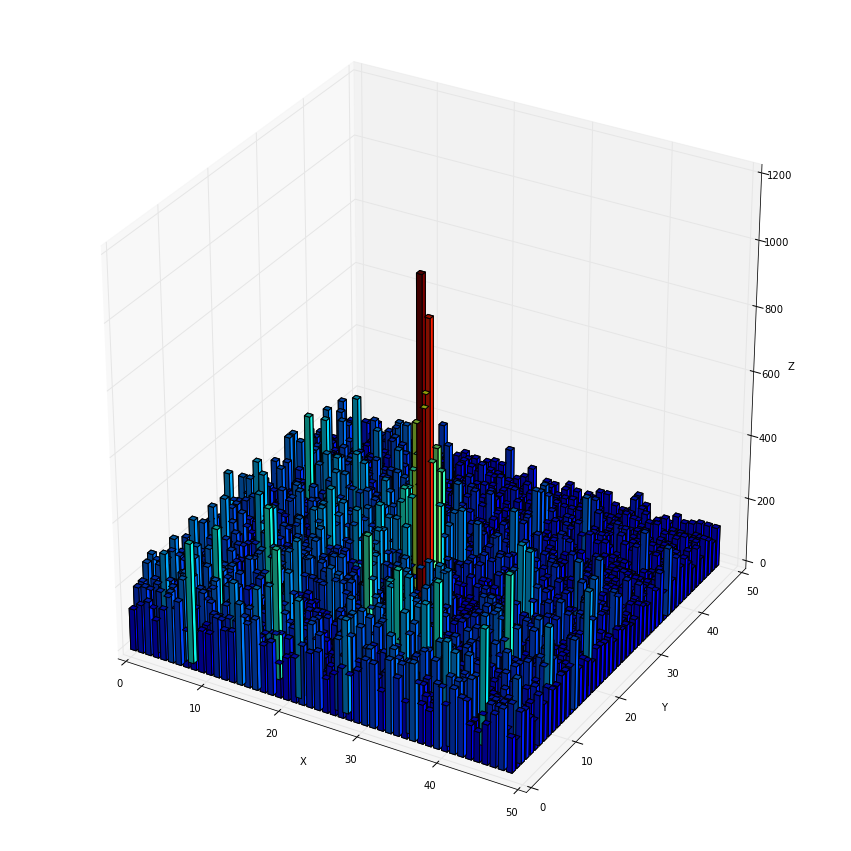

In [7]:
from mpl_toolkits.mplot3d import Axes3D

data = ImageI-1851


ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()   
ypos = ypos.flatten()
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
ax.bar3d(xpos,ypos,zpos, .7,.7,data.flatten(), color=colors)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
#plt.savefig('/Users/austinmcdonald/Desktop/CCD/CCD-image.pdf')

plt.show()

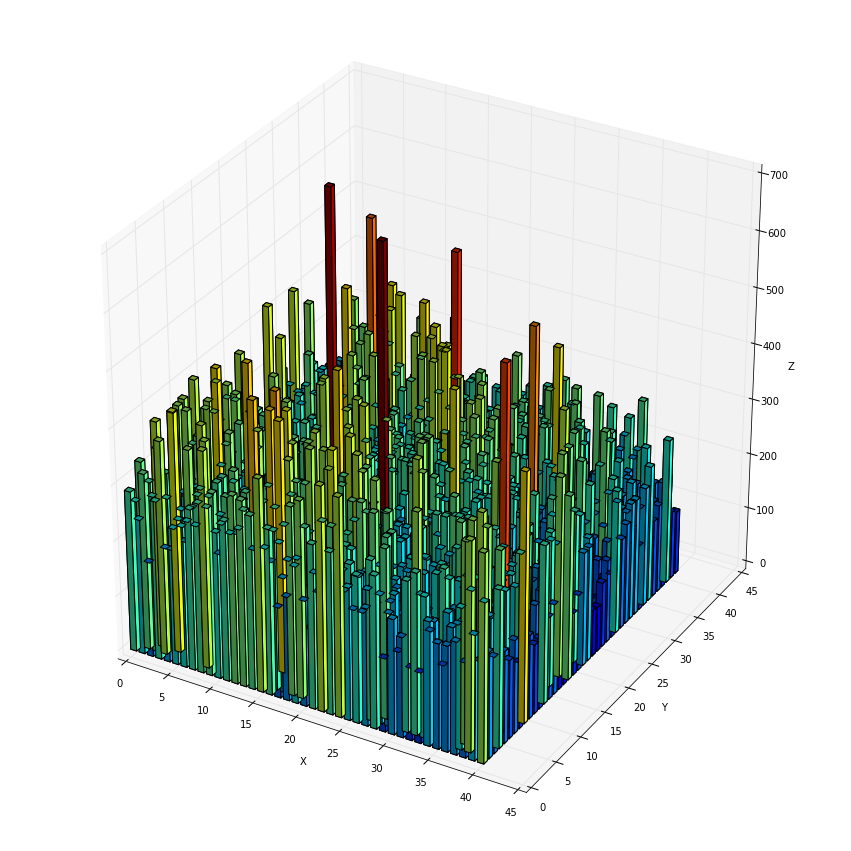

In [30]:
from mpl_toolkits.mplot3d import Axes3D

data = ImageF-1856


ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()   
ypos = ypos.flatten()
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
ax.bar3d(xpos,ypos,zpos, .7,.7,data.flatten(), color=colors)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
#plt.savefig('/Users/austinmcdonald/Desktop/CCD/CCD-image.pdf')

plt.show()

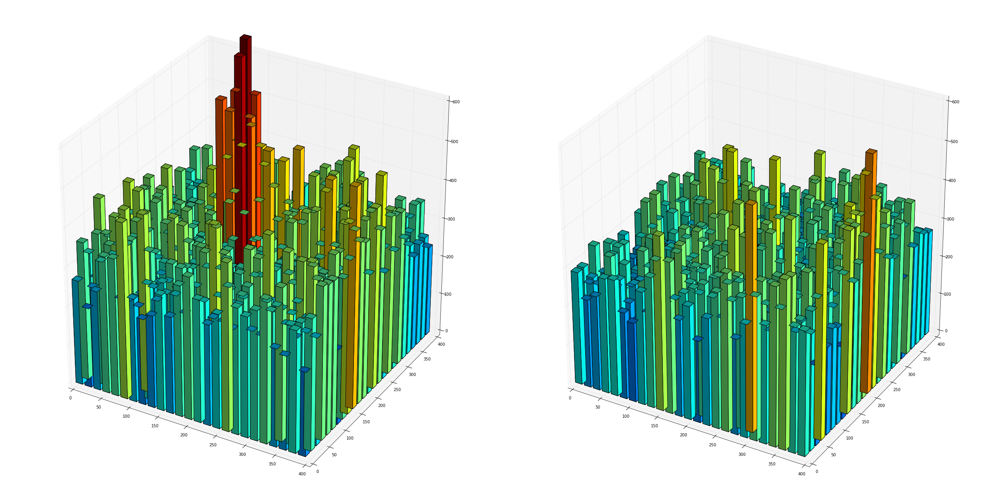

In [60]:
from mpl_toolkits.mplot3d import Axes3D

data = ImageI-1832
data2 = ImageF-1832


ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()*16  
ypos = ypos.flatten()*16
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(35,35))
ax = fig.add_subplot(221, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
ax.bar3d(xpos,ypos,zpos, 12,12,data.flatten(), color=colors)

ax2 = fig.add_subplot(222, projection='3d',sharez=ax,sharey=ax)
###ax2.title.set_text('')
colors2 = plt.cm.jet(data2.flatten()/float(data.max()))
ax2.bar3d(xpos,ypos,zpos, 12,12,data2.flatten(), color=colors2)
ax.set_zlim(0, 600)

plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/smfi/single1-site1-v2.pdf')
plt.show()

In [61]:
files = os.listdir()

In [66]:
files[0].split('.')

['Image22210_1', 'tif']

In [67]:
#extensions
#sourcedir = "/Users/austinmcdonald/Desktop/AHHH1"; number_ofdigits = 5; extensions = (".tif", ".jpeg")
#import shutil
#for item in files:
#    if item.endswith('.tif'):
#        name = item.split("."); zeros = number_ofdigits-len(name[0].split('_')[1])
#        newname = str(zeros*"0")+name[0]+"."+name[1]
#        shutil.move(sourcedir+"/"+item, sourcedir+"/"+newname)

In [69]:
files = os.listdir()

In [74]:
inital = files[:20]
final  = files[-20:]

In [82]:
II = dict()
FF = dict()
Ia=np.zeros((512,512))
Fa=np.zeros((512,512))

for x in range(0,len(inital)):
    HOLD = Image.open(inital[x])
    II[x] = np.array(HOLD)
    Ia += II[x]
for x in range(0,len(final)):
    HOLD = Image.open(final[x])
    FF[x] = np.array(HOLD)
    Fa += FF[x]
Inital = Ia/len(inital)
Final  = Fa/len(final)

In [126]:
Ini = Image.fromarray(Inital)
Fni = Image.fromarray(Final)
Ini.save('Inital.tif')
Fni.save('Final.tif')

In [85]:
Row = 12
Col = 12
Xindex = 193 
Yindex = 279
InitalM = Inital[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]
FinalM = Final[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]

In [92]:
minnI=[]
minnF=[]
for x in range(0,21):
    minnI.append(min(InitalM[x]))
    minnF.append(min(FinalM[x]))
print('min I',min(minnI) )
print('min F',min(minnF) )

min I 2068.4
min F 2056.9


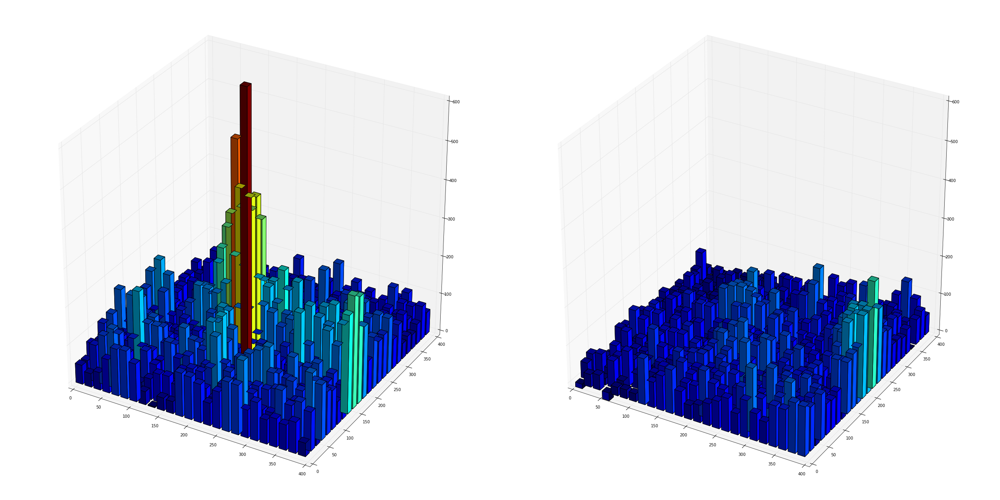

In [94]:
from mpl_toolkits.mplot3d import Axes3D

data = ImageIM-2056
data2 = ImageFM-2056


ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()*16  
ypos = ypos.flatten()*16
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(35,35))
ax = fig.add_subplot(221, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
ax.bar3d(xpos,ypos,zpos, 12,12,data.flatten(), color=colors)

ax2 = fig.add_subplot(222, projection='3d',sharez=ax,sharey=ax)
###ax2.title.set_text('')
colors2 = plt.cm.jet(data2.flatten()/float(data.max()))
ax2.bar3d(xpos,ypos,zpos, 12,12,data2.flatten(), color=colors2)
ax.set_zlim(0, 600)

plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/AHH-compar-v2.pdf')
plt.show()

In [97]:
len(files)

1113

In [134]:
files2 = files[1::30]
len(files2)

38

In [128]:
hit = dict()
#Ia=np.zeros((512,512))
#Fa=np.zeros((512,512))

for x in range(0,len(files2)):
    HOLD = Image.open(files2[x])
    hit[x] = np.array(HOLD)


In [129]:
Row = 12
Col = 12
Xindex = 193 
Yindex = 279
hitt=dict()
for x in range(0,len(files2)):
    hitt[x] = hit[x][Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]


In [130]:
minn=[]
maxx=[]
for x in range(0,len(files2)):
    minn.append(hitt[x].min())
    maxx.append(hitt[x].max())
print('min =',min(minn) )
print('max =',max(maxx))


min = 1926
max = 2887


In [132]:
names =  [str(x) for x in range(len(files2))]
names[1]

'1'

//anaconda/envs/py35/lib/python3.5/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


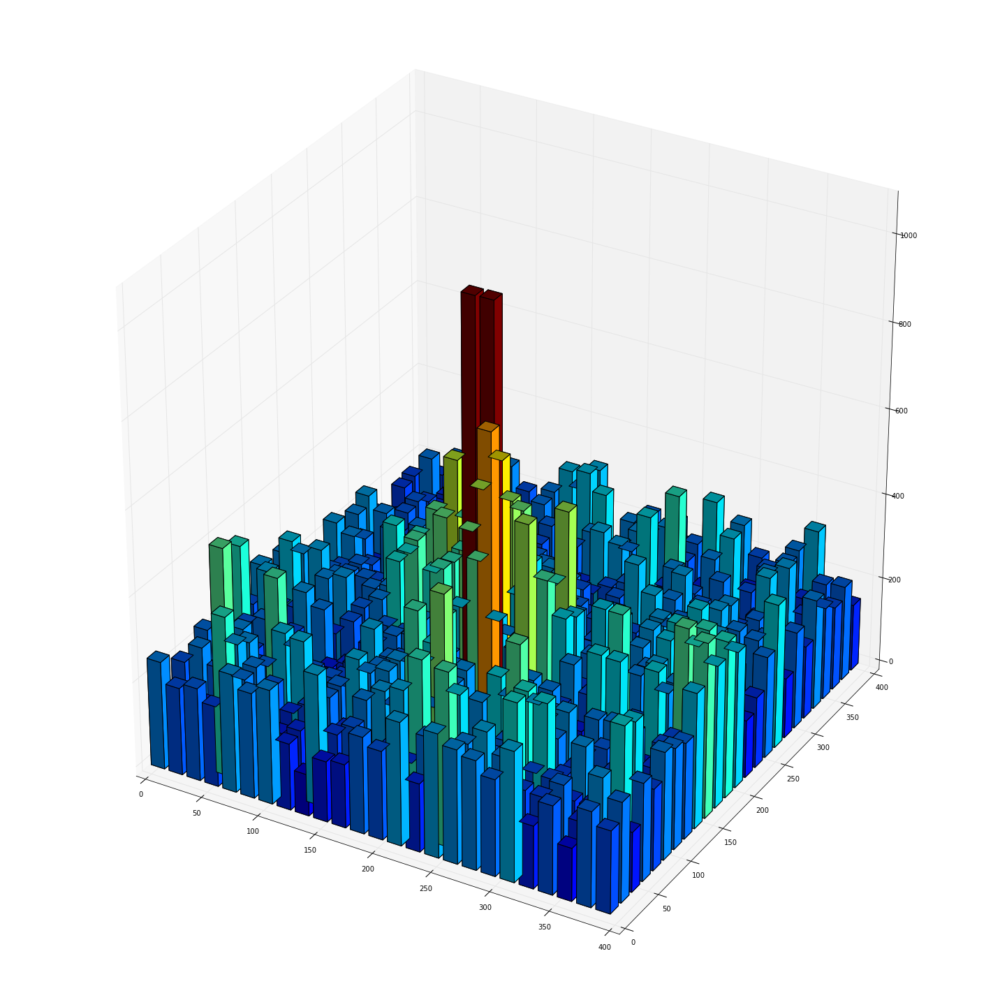

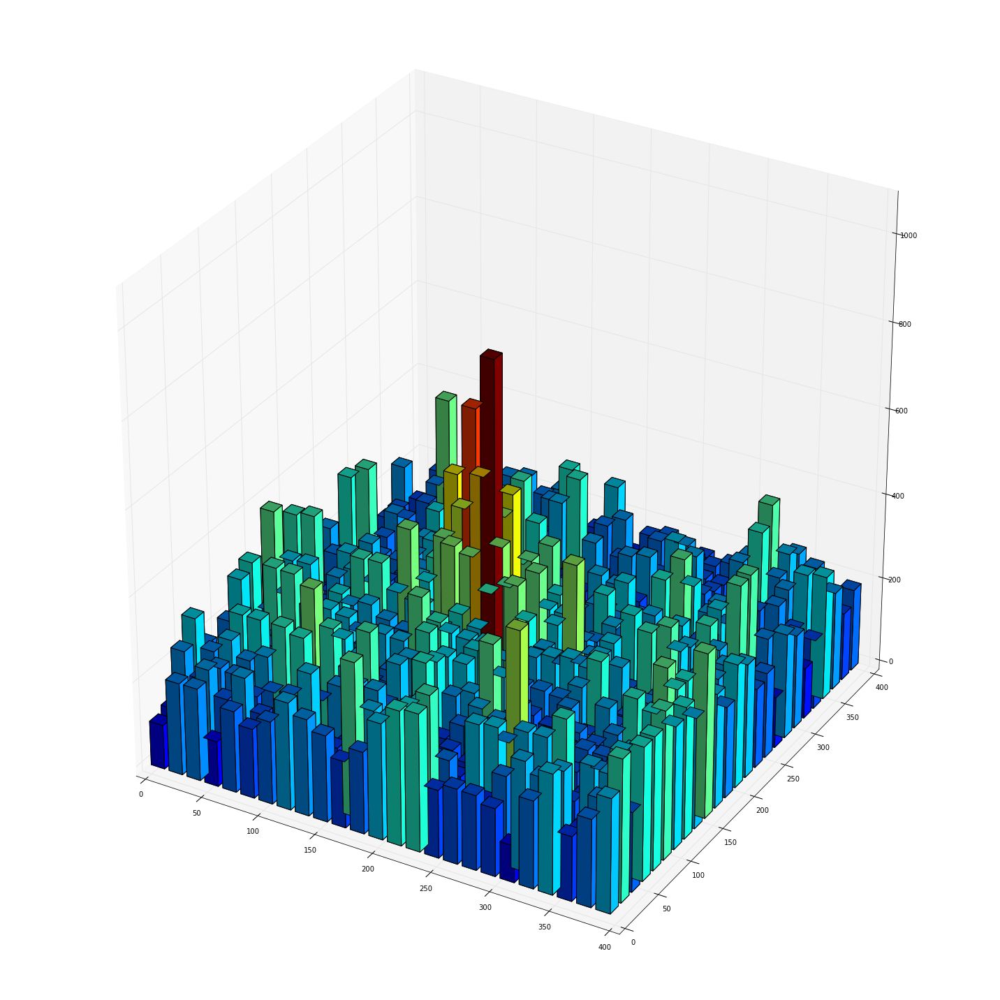

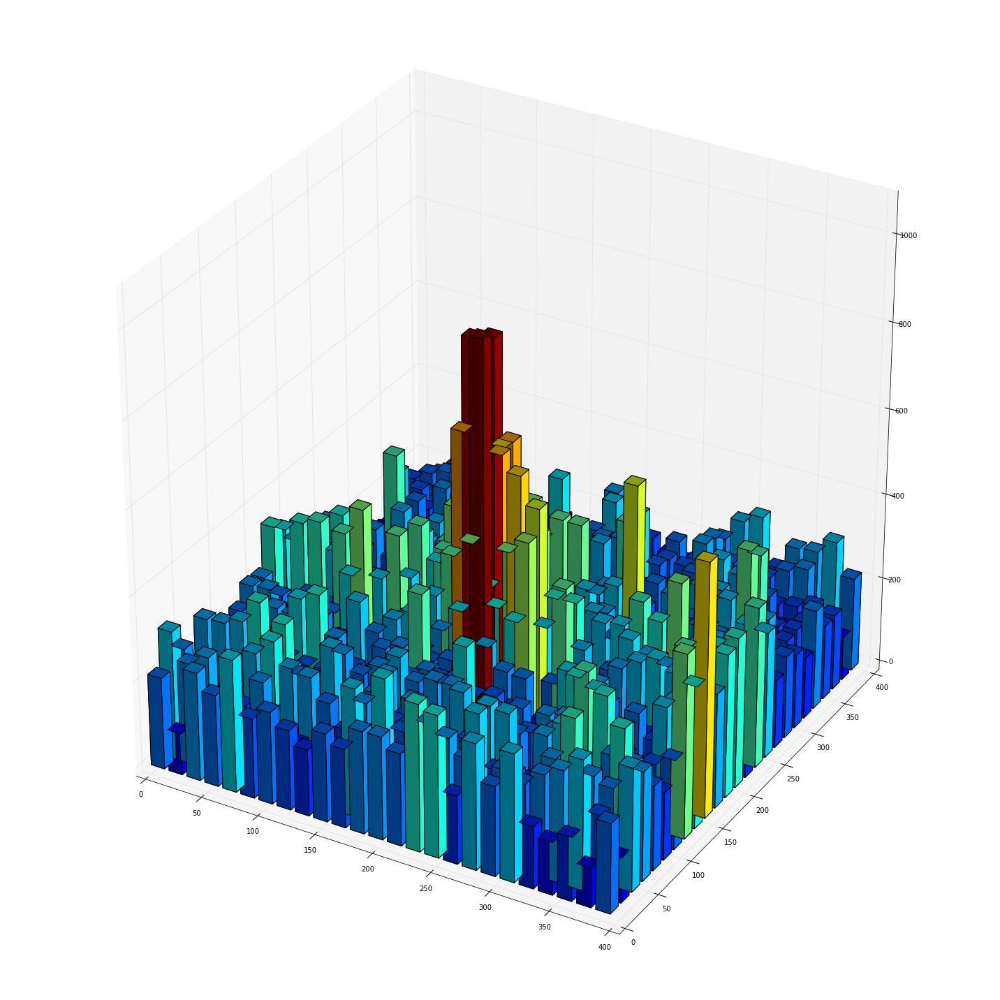

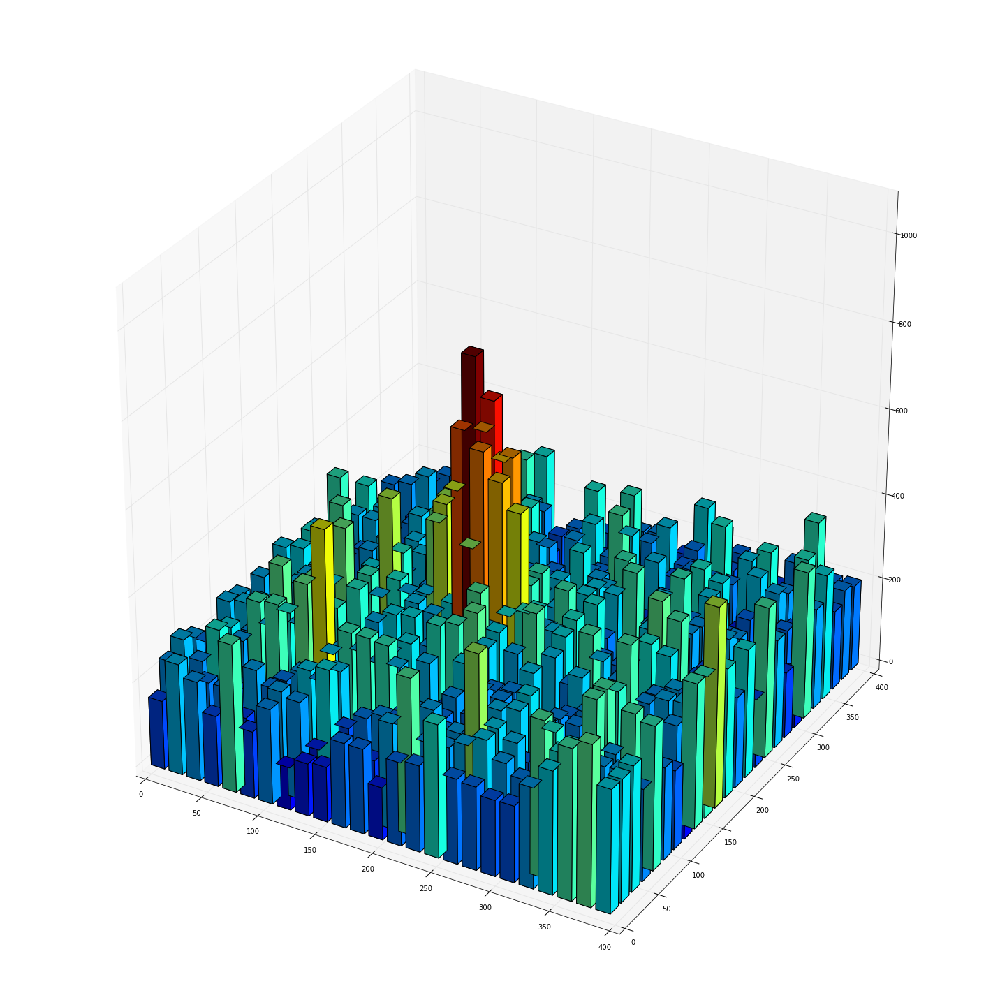

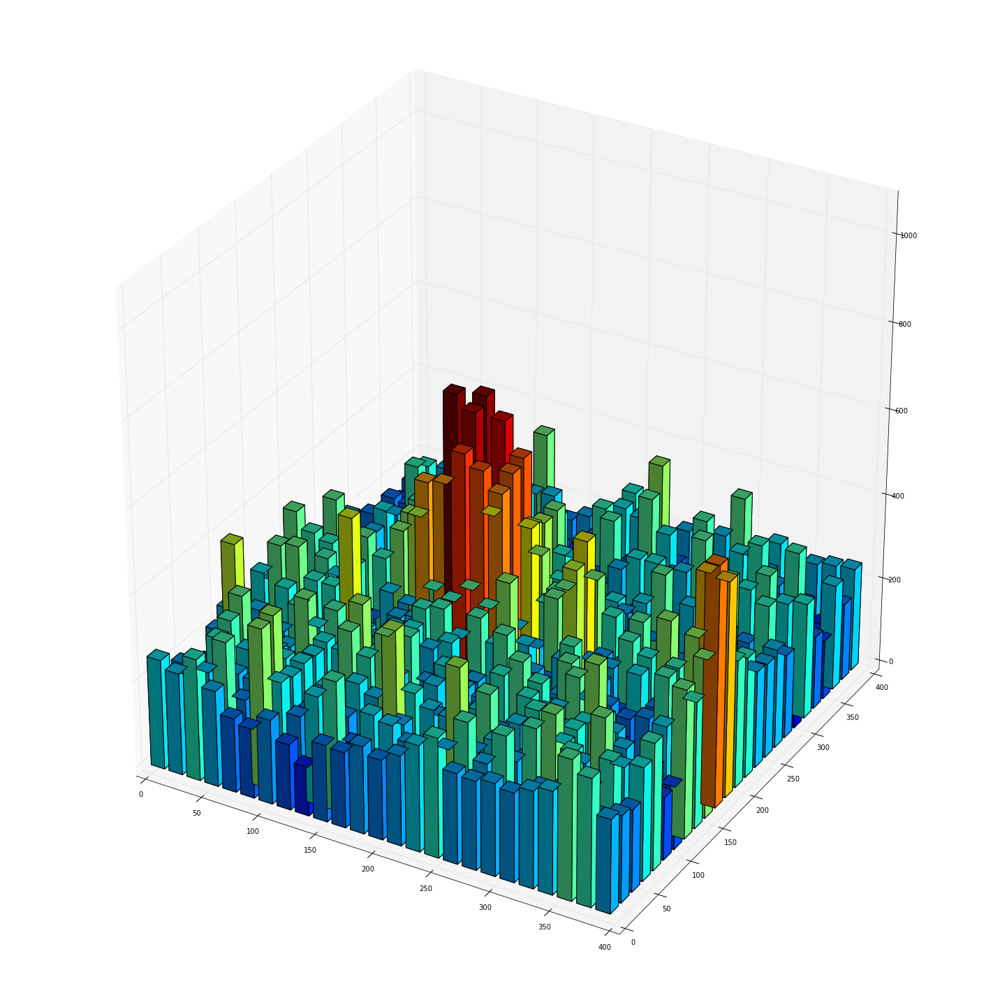

...

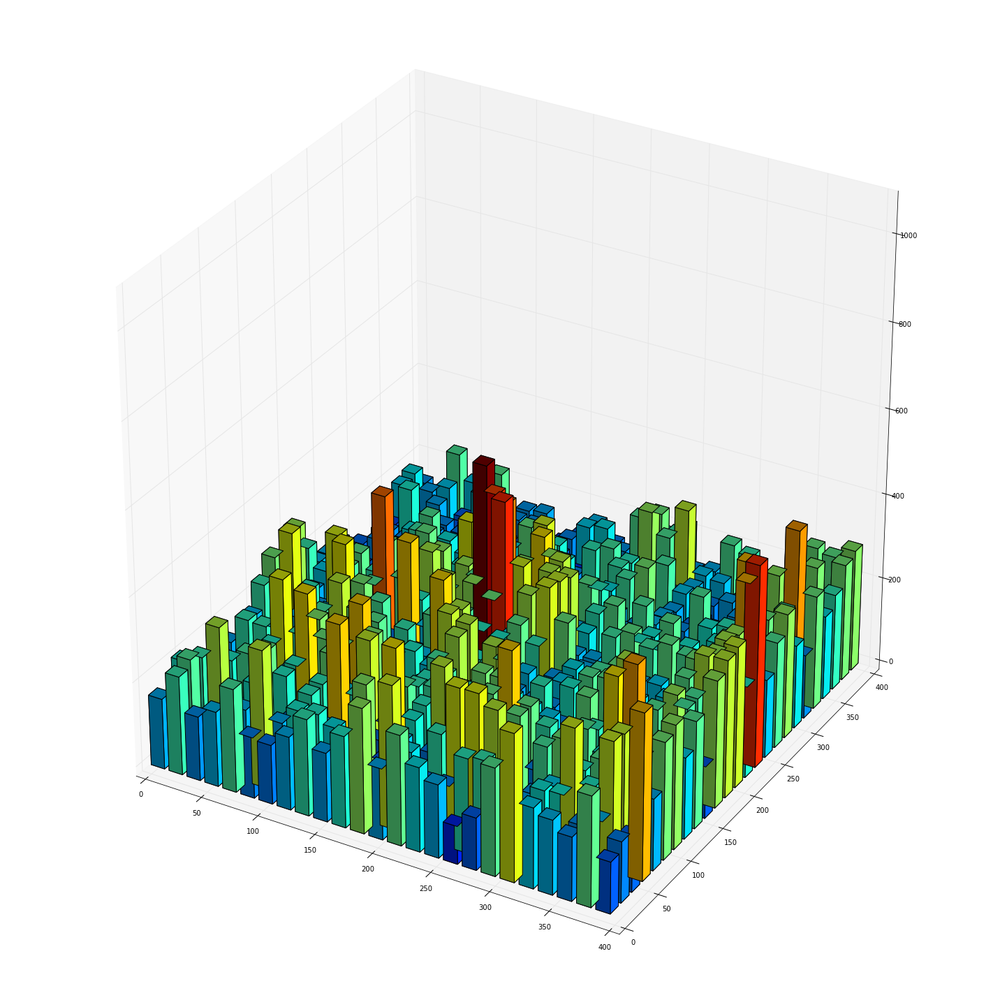

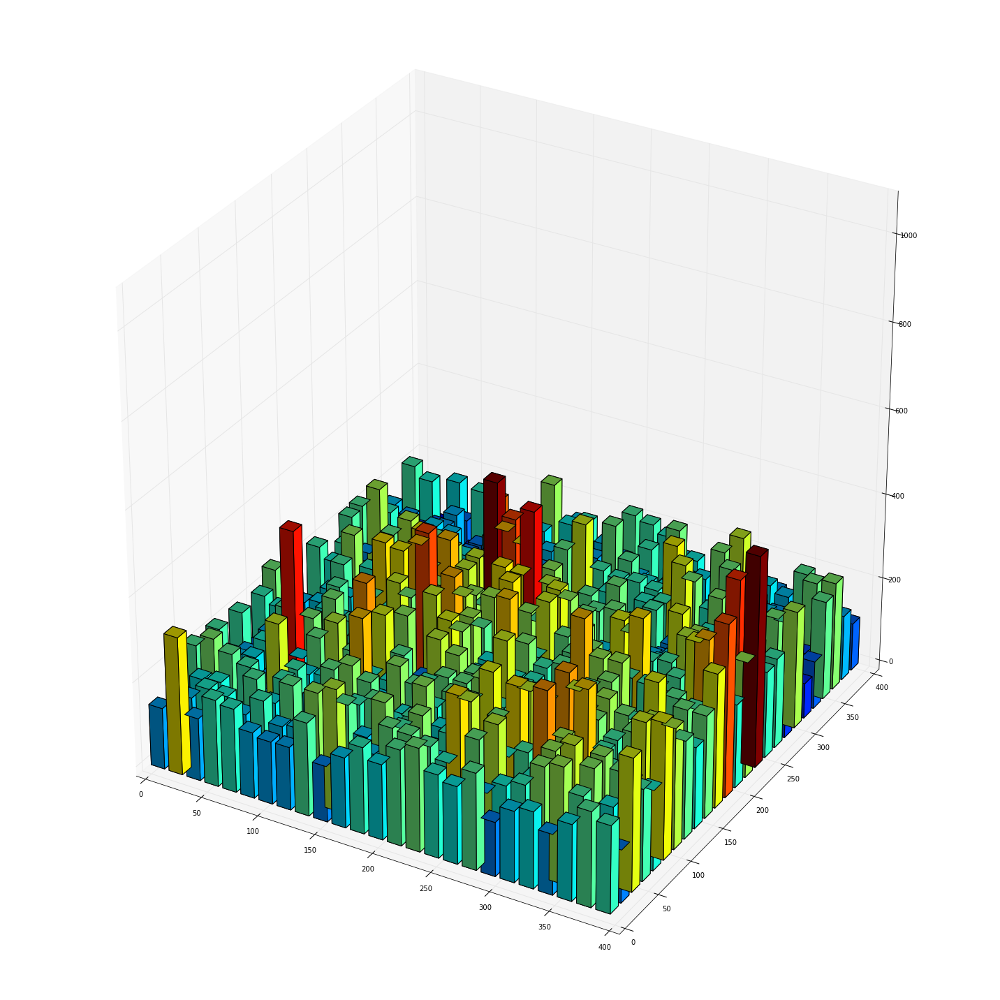

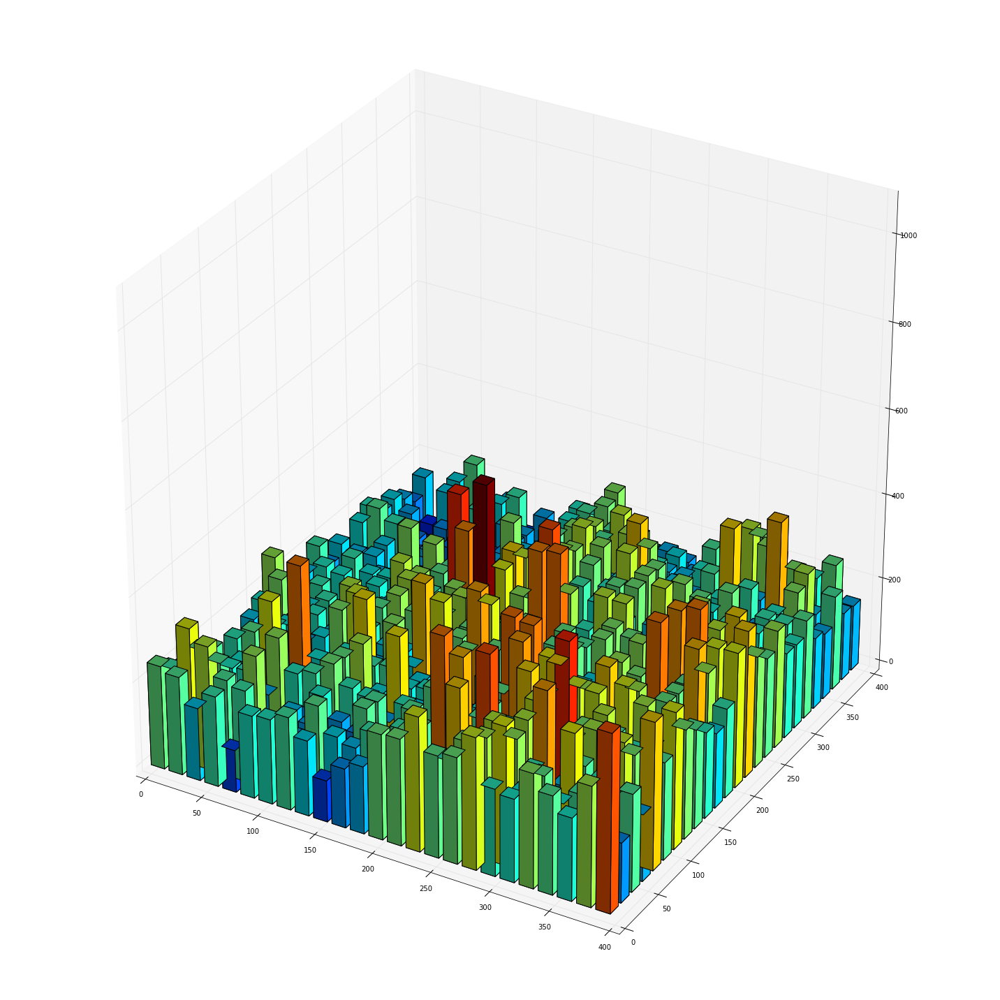

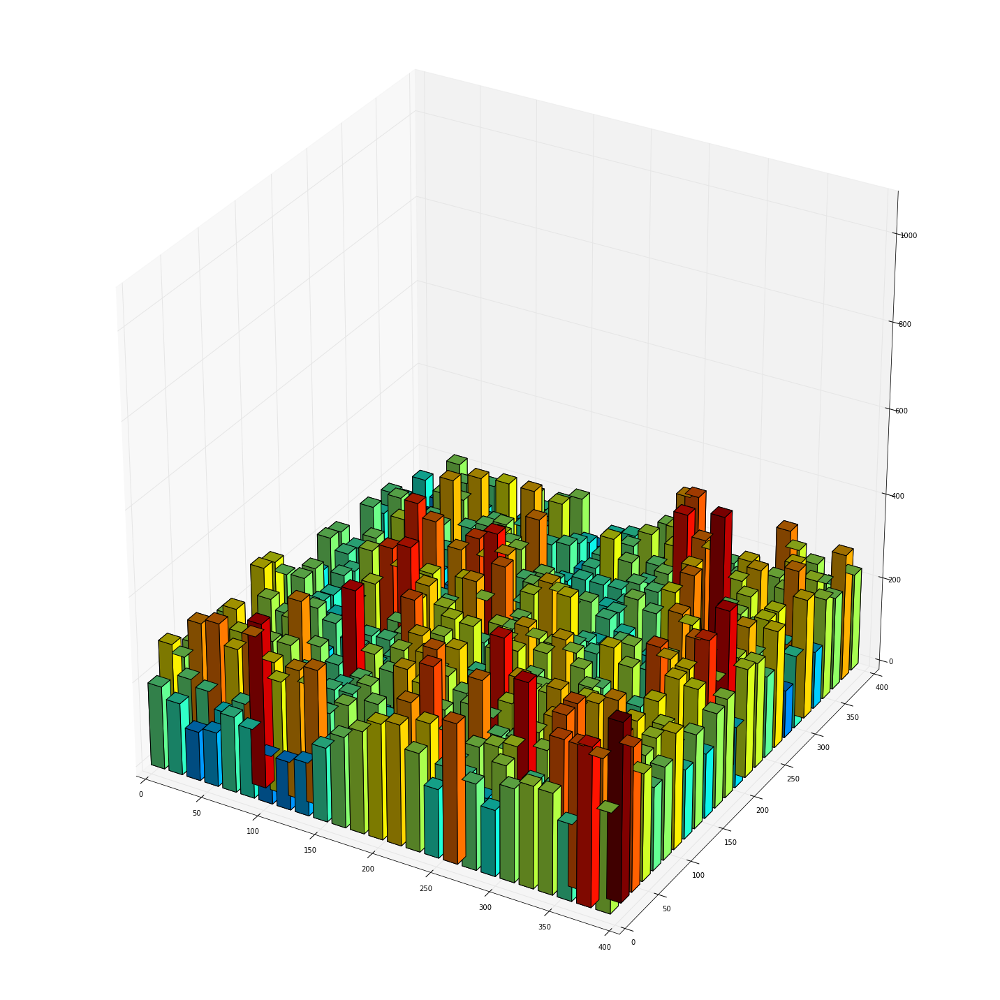

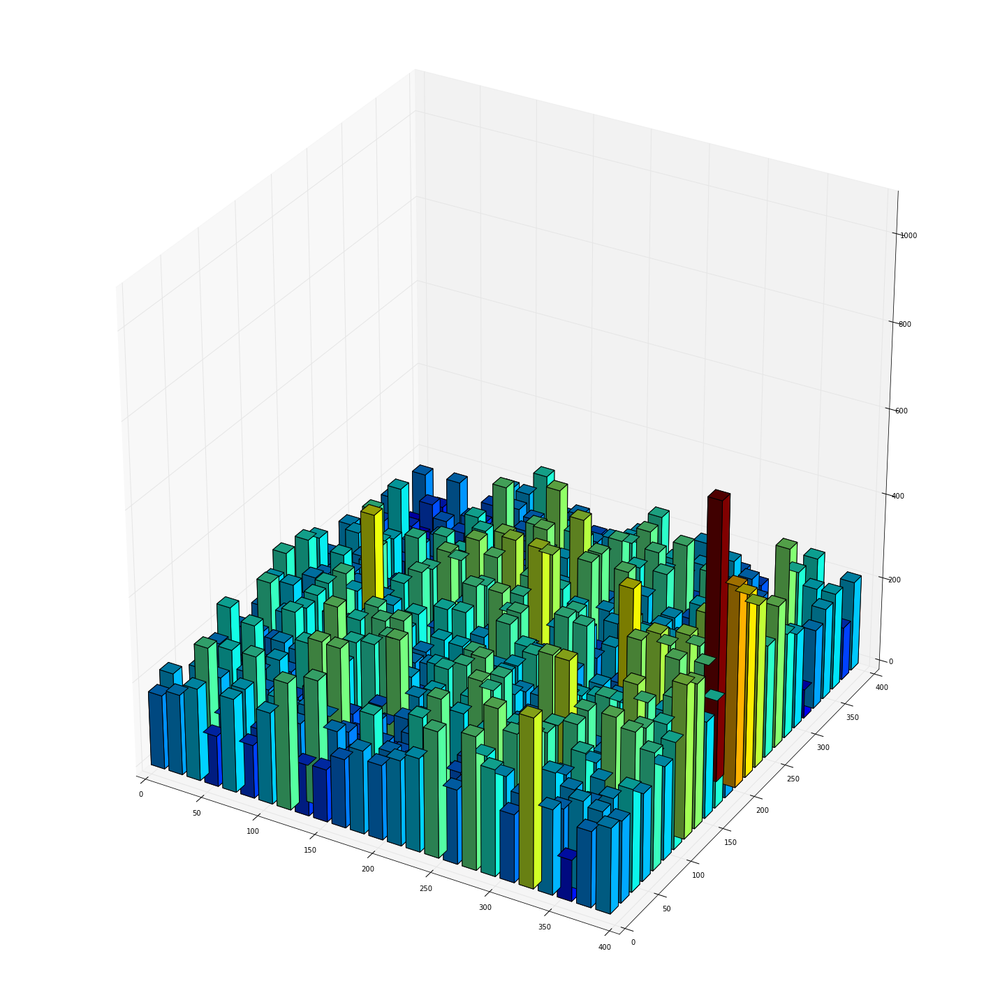

In [133]:
for x in range(0,len(files2)):
    data = hitt[x]-1927
    ypos, xpos  = np.indices(data.shape) 

    xpos = xpos.flatten()*16  
    ypos = ypos.flatten()*16
    zpos = np.zeros(xpos.shape)

    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111, projection='3d')

    colors = plt.cm.jet(data.flatten()/float(data.max()))
    ax.bar3d(xpos,ypos,zpos, 12,12,data.flatten(), color=colors)

    ax.set_zlim(0, 3000-1927)
    plt.tight_layout()
    plt.savefig('/Users/austinmcdonald/Desktop/testt2/AHH-test'+names[x]+'.png')
#plt.show()

In [156]:
files3 = files[1::3]
len(files3)

371

In [157]:
Row = 5
Col = 5
Xindex = 193 
Yindex = 279
minn=[]
maxx=[]

area = dict()

for x in range(0,len(files3)):
    HOLD = Image.open(files3[x])
    area[x] = np.array(HOLD)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]
    minn.append(area[x].min())
    maxx.append(area[x].max())
print('min =',min(minn) )
print('max =',max(maxx))

min = 1936
max = 3048


In [139]:
area[0].shape

(11, 11)

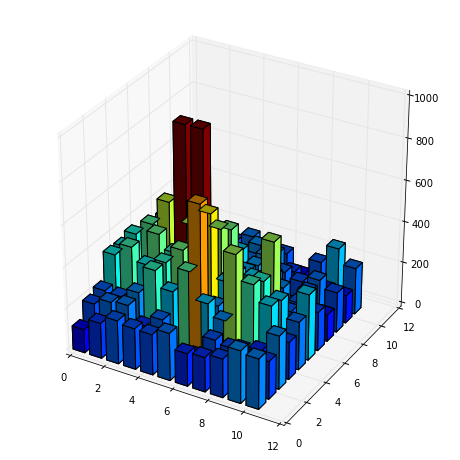

In [158]:

data = area[0]-1936
ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()   
ypos = ypos.flatten()
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
ax.bar3d(xpos,ypos,zpos, .7,.7,data.flatten(), color=colors)
plt.show()

In [146]:
area[0].sum()

265900

In [159]:
vals=[]
for x in range(0,len(files3)):
    vals.append((area[x]-1936).sum())

In [160]:
vals[-5:]

[23878, 24618, 25424, 23841, 23944]

In [161]:
h=np.arange(0,len(vals))

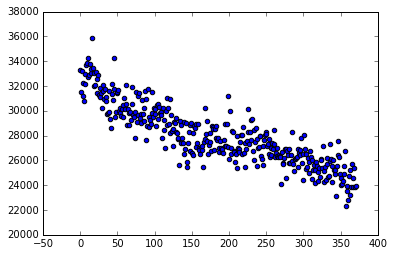

In [162]:
plt.scatter(h,vals)